# Libraries

In [65]:
# Standard Library Imports
import os
import sys
import json
import ssl
import shutil
from pathlib import Path
from collections import defaultdict
from random import sample
from typing import Any

ssl._create_default_https_context = ssl._create_unverified_context  # Ignore SSL certificate verification

# Data Science Libraries
import numpy as np
import pandas as pd

# Visualization Libraries
import matplotlib.pyplot as plt
from matplotlib.pyplot import subplots, show
import seaborn as sns

# Deep Learning Libraries - TensorFlow and Keras
import tensorflow as tf
from tensorflow.keras import Sequential, Input, layers, Model
from tensorflow.keras.layers import (
    Conv2D, MaxPooling2D, Flatten, Dropout, Dense,
    BatchNormalization, RandomFlip, RandomRotation,
    RandomZoom, Rescaling
)
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.metrics import AUC
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, EarlyStopping
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Alternative: Standalone Keras Imports
from keras import Model, Sequential, Input
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, LeakyReLU
from keras.optimizers import SGD
from keras.losses import CategoricalCrossentropy
from keras.metrics import CategoricalAccuracy, AUC, F1Score
from keras.callbacks import ModelCheckpoint, CSVLogger, LearningRateScheduler
from keras.utils import to_categorical
from keras.datasets.cifar10 import load_data as load_cifar10

# Deep Learning Libraries - PyTorch and Torchvision
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from torch.optim import AdamW
from torch.optim.lr_scheduler import ReduceLROnPlateau
import torch.optim as optim

# Machine Learning Libraries - scikit-learn
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils.class_weight import compute_class_weight

# Utility Libraries
from PIL import Image
from tqdm import tqdm
import open_clip
from torchvision.datasets import ImageFolder



# Import Data

In [2]:
df = pd.read_csv(r'/Users/ricardokayseller/Desktop/metadata.csv', sep=',')


In [3]:
df

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...
3,29cc6040-6af2-49ee-86ec-ab7d89793828,29658536,45510188,animalia,chordata,turdidae,chordata_turdidae/29658536_45510188_eol-full-s...
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...
...,...,...,...,...,...,...,...
11978,1fa96ea5-32fa-4a25-b8d2-fa99f6e2cb89,29734618,1011315,animalia,chordata,leporidae,chordata_leporidae/29734618_1011315_eol-full-s...
11979,628bf2b4-6ecc-4017-a8e6-4306849e0cfc,29972861,1056842,animalia,chordata,emydidae,chordata_emydidae/29972861_1056842_eol-full-si...
11980,0ecfdec9-b1cd-4d43-96fc-2f8889ec1ad9,30134195,52572074,animalia,chordata,dasyatidae,chordata_dasyatidae/30134195_52572074_eol-full...
11981,27fdb1e9-c5fb-459a-8b6a-6fb222b1c512,9474963,46559139,animalia,chordata,mustelidae,chordata_mustelidae/9474963_46559139_eol-full-...


# 1. Data Understanding

## 1.1 Data Analyze

### 1.1.1 Info

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11983 entries, 0 to 11982
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   rare_species_id  11983 non-null  object
 1   eol_content_id   11983 non-null  int64 
 2   eol_page_id      11983 non-null  int64 
 3   kingdom          11983 non-null  object
 4   phylum           11983 non-null  object
 5   family           11983 non-null  object
 6   file_path        11983 non-null  object
dtypes: int64(2), object(5)
memory usage: 655.4+ KB


### 1.1.2 Columns of dataset

In [5]:
df.columns

Index(['rare_species_id', 'eol_content_id', 'eol_page_id', 'kingdom', 'phylum',
       'family', 'file_path'],
      dtype='object')

### 1.1.3 Summary

In [6]:
# Summary statistics (only numeric columns)
summary_stats = df.describe()
summary_stats

,eol_content_id,eol_page_id
count,1.198300e+04,1.198300e+04
mean,2.297681e+07,2.112247e+07
std,6.999289e+06,2.241319e+07
min,4.750000e+02,1.180080e+05
25%,2.058937e+07,7.954560e+05
50%,2.251368e+07,2.865857e+06
75%,2.932887e+07,4.551773e+07
max,3.061946e+07,5.269200e+07


### 1.1.4 Missing Values

In [7]:
df.isnull().sum()

rare_species_id    0
eol_content_id     0
eol_page_id        0
kingdom            0
phylum             0
family             0
file_path          0
dtype: int64

### 1.1.5 Duplicated Values

In [8]:
df.duplicated().sum()

0

### 1.1.6 Total images

In [9]:
total_images = len(df)
total_images

11983

### 1.1.7 Number of families

In [10]:
# Number of unique families (target classes)
df['family'].unique()

array(['unionidae', 'geoemydidae', 'cryptobranchidae', 'turdidae',
       'indriidae', 'formicidae', 'fringillidae', 'gomphidae',
       'myliobatidae', 'pleuronectidae', 'nesospingidae', 'dasyuridae',
       'accipitridae', 'glareolidae', 'trogonidae', 'carcharhinidae',
       'diomedeidae', 'gavialidae', 'salamandridae', 'iguanidae',
       'delphinidae', 'gekkonidae', 'procellariidae', 'daubentoniidae',
       'pittidae', 'aotidae', 'platystictidae', 'serranidae',
       'rhacophoridae', 'alcedinidae', 'bufonidae', 'dactyloidae',
       'tropiduridae', 'stichopodidae', 'caprimulgidae',
       'cercopithecidae', 'bucerotidae', 'pocilloporidae', 'sciuridae',
       'latimeriidae', 'ctenomyidae', 'mustelidae', 'anatidae',
       'euphylliidae', 'charadriidae', 'plethodontidae', 'bombycillidae',
       'thraupidae', 'cerambycidae', 'agariciidae', 'diplodactylidae',
       'bovidae', 'otididae', 'rhyacotritonidae', 'carettochelyidae',
       'percidae', 'phrynosomatidae', 'labridae', 'ph

### 1.1.8 Least common families

In [11]:
# Identify least common families
df['family'].idxmin(), df['family'].min()

(12, 'accipitridae')

### 1.1.9 Most common families

In [12]:
df['family'].idxmax(), df['family'].max()

(686, 'zonitidae')

## 1.2 Data Distribution

### 1.2.1 Distribution of data

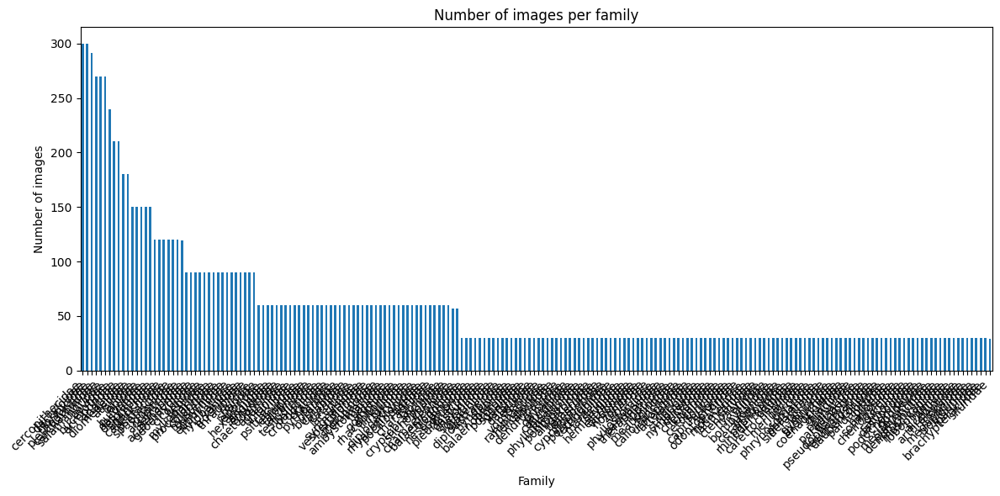

In [13]:
# Count number of images per family
family_counts = df["family"].value_counts()

# Plot the distribution
plt.figure(figsize=(12, 6))
family_counts.plot(kind="bar")
plt.title("Number of images per family")
plt.xlabel("Family")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

In [14]:
family_counts = df['family'].value_counts()
imbalance_ratio = family_counts.max() / family_counts.min()

print(f"Imbalance Ratio: {imbalance_ratio:.2f}")


Imbalance Ratio: 10.34


### 1.2.2 Gini Coefficient

In [15]:
def gini(array):
    array = np.sort(array)
    index = np.arange(1, array.shape[0] + 1)
    n = array.shape[0]
    return ((np.sum((2 * index - n - 1) * array)) / (n * np.sum(array)))

family_counts = df['family'].value_counts()
gini_coefficient = gini(family_counts.values)

print(f"Gini Coefficient: {gini_coefficient:.3f}")


Gini Coefficient: 0.375


### 1.2.3 Distribution of top 20 families

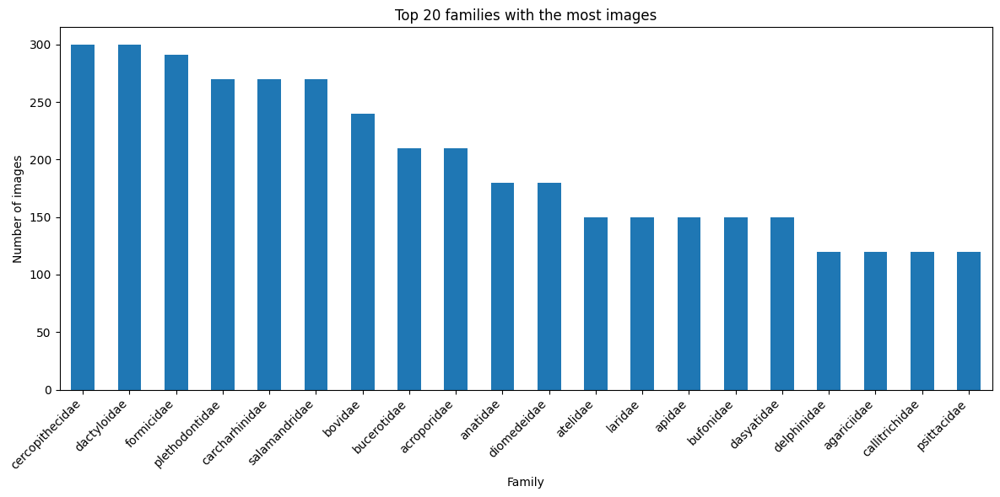

In [16]:
# Count number of images per family (Top 20 only)
family_counts = df["family"].value_counts().head(20)

# Plot the distribution
plt.figure(figsize=(12, 6))
family_counts.plot(kind="bar")
plt.title("Top 20 families with the most images")
plt.xlabel("Family")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

### 1.2.4 Values count for each categorical

In [17]:
# Show unique value counts for each categorical column
categorical_columns = ["kingdom", "phylum", "family"]

for col in categorical_columns:
    print(f"\nValue counts for column: {col}")
    print(df[col].value_counts())


Value counts for column: kingdom
kingdom
animalia    11983
Name: count, dtype: int64

Value counts for column: phylum
phylum
chordata         9952
arthropoda        951
cnidaria          810
mollusca          210
echinodermata      60
Name: count, dtype: int64

Value counts for column: family
family
cercopithecidae      300
dactyloidae          300
formicidae           291
plethodontidae       270
carcharhinidae       270
                    ... 
megapodiidae          30
tropiduridae          30
parulidae             30
brachypteraciidae     30
siluridae             29
Name: count, Length: 202, dtype: int64


### 1.2.5 Images distributon for 'phylum'

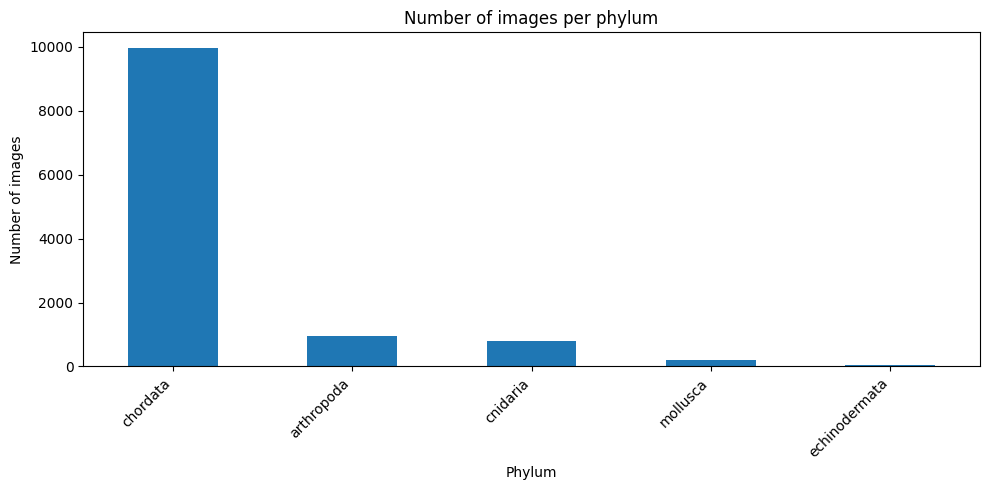

In [18]:
phylum_counts = df["phylum"].value_counts()

plt.figure(figsize=(10, 5))
phylum_counts.plot(kind="bar")
plt.title("Number of images per phylum")
plt.xlabel("Phylum")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

### 1.2.6 Images distributon for 'phylum'

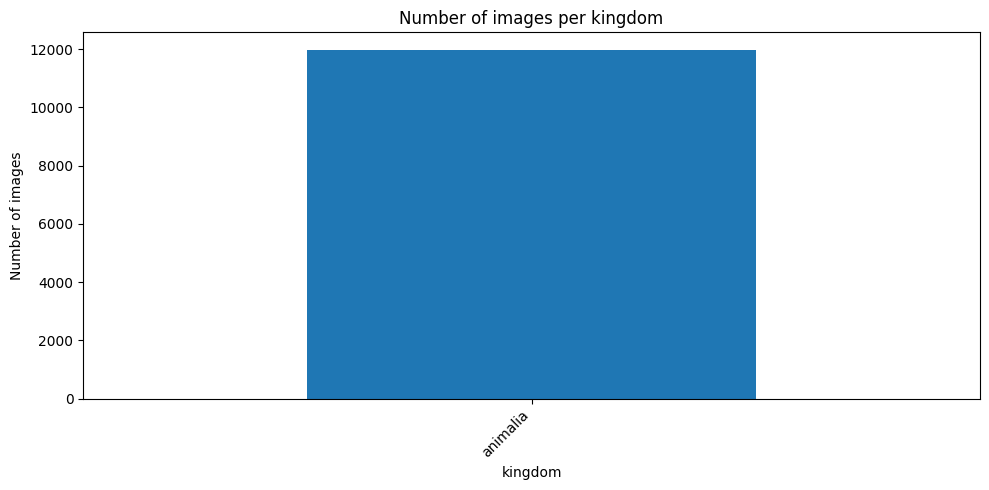

In [19]:
phylum_counts = df["kingdom"].value_counts()

plt.figure(figsize=(10, 5))
phylum_counts.plot(kind="bar")
plt.title("Number of images per kingdom")
plt.xlabel("kingdom")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

In [20]:
rare_families = (family_counts == 10).sum()
print(f"Number of families with only ten image: {rare_families}")

Number of families with only ten image: 0


## 1.3 Directory Check

### 1.3.1 Root directory of images

In [22]:
# Image root directory
root_dir = r'/Users/ricardokayseller/Desktop/DATA2'


# Caminho absoluto para cada imagem
df["full_path"] = df["file_path"].apply(lambda x: os.path.join(root_dir, x))

# Nome da coluna com os rótulos (para o modelo)
df["label"] = df["family"]

# Opcional: filtrar classes com pelo menos 5 imagens
# df = df.groupby("label").filter(lambda x: len(x) >= 5)

### 1.3.2 Validate root directory of images

In [24]:
root_dir = r'/Users/ricardokayseller/Desktop/DATA2'

df["full_path"] = df["file_path"].apply(lambda x: os.path.join(root_dir, x))

# Verificar os primeiros 10 caminhos
for path in df["full_path"].head(10):
    print(path, "->", os.path.exists(path))


/Users/ricardokayseller/Desktop/DATA2/mollusca_unionidae/12853737_449393_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_geoemydidae/20969394_793083_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_cryptobranchidae/28895411_319982_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_turdidae/29658536_45510188_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_indriidae/21252576_7250886_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/arthropoda_formicidae/28657539_491832_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_fringillidae/29548208_47043290_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/arthropoda_gomphidae/21232818_1033999_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2/chordata_myliobatidae/20315204_46561012_eol-full-size-copy.jpg -> True
/Users/ricardokayseller/Desktop/DATA2

In [25]:
# Original image dataset
data_dir = r'/Users/ricardokayseller/Desktop/DATA2'

# New clean directory to save filtered images
clean_dir = r'/Users/ricardokayseller/Desktop/DATA_CLEAN'
os.makedirs(clean_dir, exist_ok=True)

## 1.4 Data Preprocessing

### 1.4.1 BiGAN to remove noise

#### 1.4.1.1 Anomaly Detection with BiGAN


In [26]:
# Select device (GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(" Using device:", device)

# Set image parameters
image_size = 224
latent_dim = 100
batch_size = 224

# Transformations for the dataset
transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor()
])

# Define your real dataset path
data_path = r'/Users/ricardokayseller/Desktop/DATA2'

# Load images from folders
real_dataset = datasets.ImageFolder(root=data_path, transform=transform)

# Create DataLoader
loader = DataLoader(real_dataset, batch_size=batch_size, shuffle=True)

class Encoder(nn.Module):
    def __init__(self, latent_dim=100):
        super(Encoder, self).__init__()
        self.model = nn.Sequential(
            nn.Flatten(),
            nn.Linear(3 * image_size * image_size, 512),
            nn.ReLU(),
            nn.Linear(512, latent_dim)
        )

    def forward(self, x):
        return self.model(x)

class Generator(nn.Module):
    def __init__(self, latent_dim=100):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(latent_dim, 512),
            nn.ReLU(),
            nn.Linear(512, 3 * image_size * image_size),
            nn.Tanh()
        )

    def forward(self, z):
        return self.model(z).view(-1, 3, image_size, image_size)

class Discriminator(nn.Module):
    def __init__(self, latent_dim=100):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(latent_dim + 3 * image_size * image_size, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def forward(self, x, z):
        x_flat = x.view(x.size(0), -1)
        return self.model(torch.cat([x_flat, z], dim=1))

encoder = Encoder(latent_dim).to(device)
generator = Generator(latent_dim).to(device)
discriminator = Discriminator(latent_dim).to(device)

opt_E = optim.Adam(encoder.parameters(), lr=2e-4)
opt_G = optim.Adam(generator.parameters(), lr=2e-4)
opt_D = optim.Adam(discriminator.parameters(), lr=2e-4)

bce_loss = nn.BCELoss()



 Using device: cpu


#### 1.4.1.2 Training Function BiGAN

In [27]:
# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Transformation: Resize + Tensor
transformations = transforms.Compose([
    transforms.Resize((image_size, image_size)),   # Match BiGAN input size
    transforms.ToTensor()
])

# Define your encoder and generator here (assumed already loaded and in eval mode)
# from model_definition import encoder, generator

# Root with your 201 folders
ROOT_DIR = r'/Users/ricardokayseller/Desktop/DATA2'
OUTPUT_DIR = r'/Users/ricardokayseller/Desktop/ANOMALY_SCORES'
os.makedirs(OUTPUT_DIR, exist_ok=True)

# BiGAN scoring function
def compute_anomaly_scores_bigan(dataloader, encoder, generator):
    scores = []
    encoder.eval()
    generator.eval()
    with torch.no_grad():
        for imgs in dataloader:
            if isinstance(imgs, (list, tuple)):
                imgs = imgs[0]
            imgs = imgs.to(device)
            z = encoder(imgs)
            recon = generator(z)
            score = torch.mean((imgs - recon) ** 2, dim=[1, 2, 3])  # MSE
            scores.extend(score.cpu().numpy())
    return np.array(scores)

# Loop through folders
for folder in os.listdir(ROOT_DIR):
    folder_path = os.path.join(ROOT_DIR, folder)

    if not os.path.isdir(folder_path):
        continue

    out_file = os.path.join(OUTPUT_DIR, f"{folder}_scores.npy")
    if os.path.exists(out_file):
        print(f" Already processed: {folder}")
        continue

    print(f" Processing: {folder}")

    dataset = ImageFolder(ROOT_DIR, transform=transformations)
    class_index = dataset.class_to_idx.get(folder)
    
    if class_index is None:
        print(f" Could not find class index for {folder}")
        continue

    # Filter images from the folder
    folder_samples = [s for s in dataset.samples if s[1] == class_index]
    dataset.samples = folder_samples

    dataloader = DataLoader(dataset, batch_size=32, shuffle=False)

    scores = compute_anomaly_scores_bigan(dataloader, encoder, generator)

    np.save(out_file, scores)
    print(f" Scores saved to: {out_file}")

 Processing: chordata_balaenidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_balaenidae_scores.npy
 Processing: chordata_ardeidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_ardeidae_scores.npy
 Processing: chordata_pleuronectidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_pleuronectidae_scores.npy
 Processing: chordata_goodeidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_goodeidae_scores.npy
 Processing: chordata_plethodontidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_plethodontidae_scores.npy
 Processing: chordata_labridae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_labridae_scores.npy
 Processing: cnidaria_agariciidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/cnidaria_agariciidae_scores.npy
 Processing: mollusca_cardiidae


/Users/ricardokayseller/anaconda3/envs/tf_m1_clean/lib/python3.9/site-packages/PIL/Image.py:3442: DecompressionBombWarning: Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/mollusca_cardiidae_scores.npy
 Processing: chordata_cervidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_cervidae_scores.npy
 Processing: arthropoda_papilionidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/arthropoda_papilionidae_scores.npy
 Processing: chordata_dasypodidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_dasypodidae_scores.npy
 Processing: chordata_turdidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_turdidae_scores.npy
 Processing: chordata_recurvirostridae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_recurvirostridae_scores.npy
 Processing: chordata_tropiduridae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_tropiduridae_scores.npy
 Processing: chordata_vombatidae
 Scores saved to: /Users/ricardokayseller/Desktop/ANOMALY_SCORES/chordata_vombat

#### 1.4.1.3 Open top noise files


 Class: arthropoda_apidae


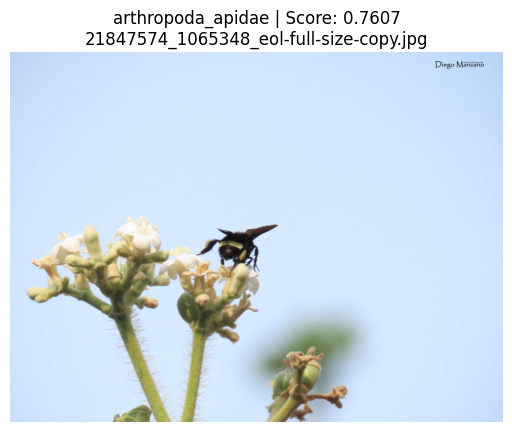

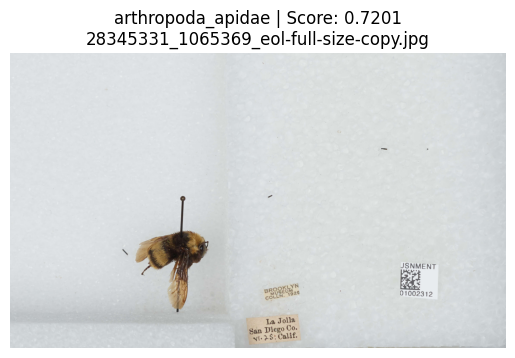

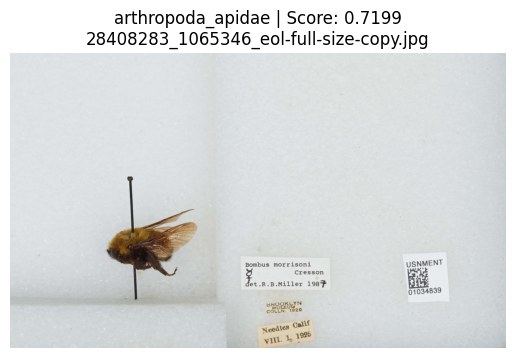

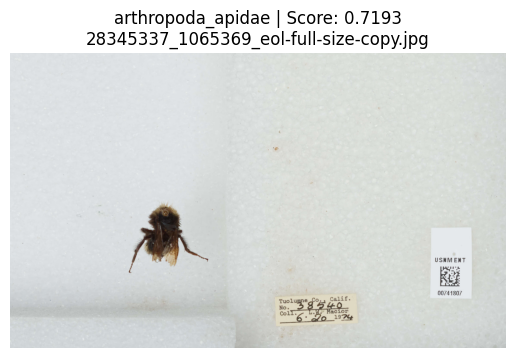

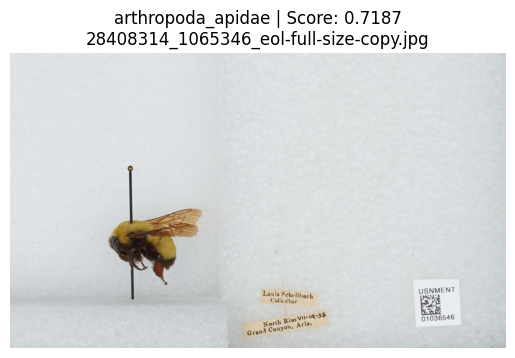

...

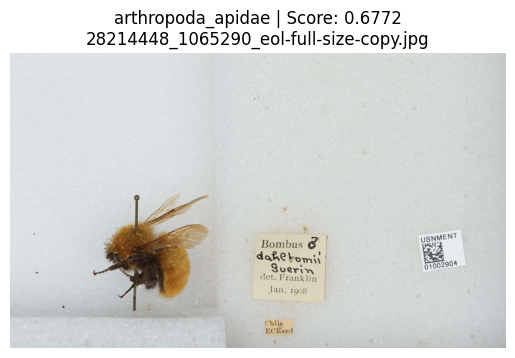

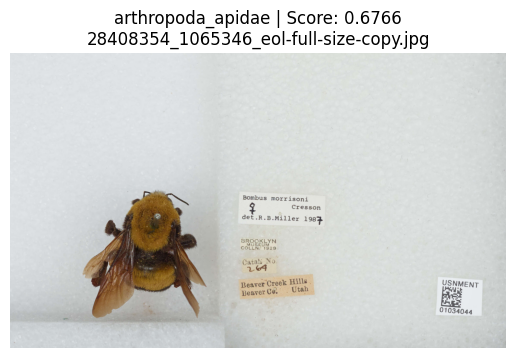

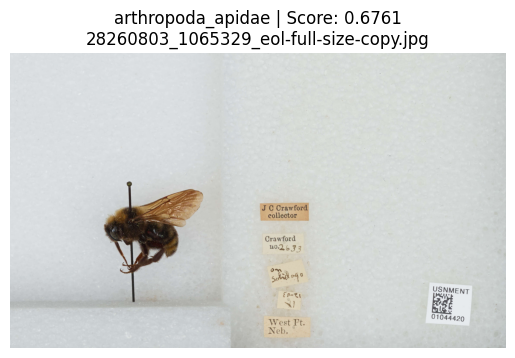

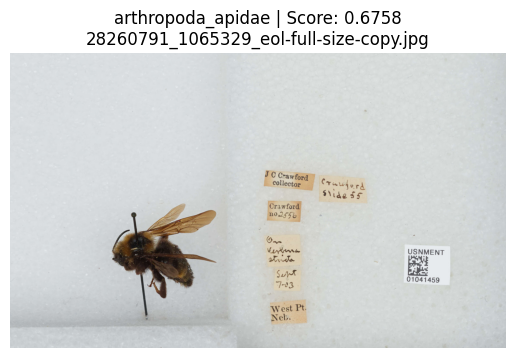

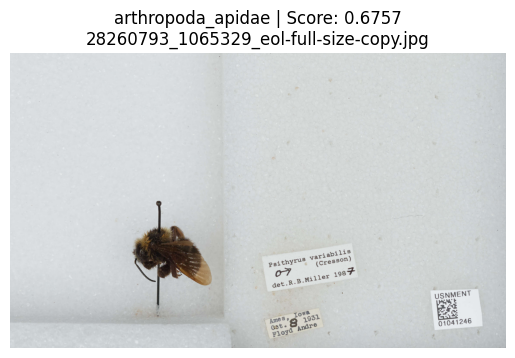

In [28]:
# Configurations
ANOMALY_SCORES_DIR = r'/Users/ricardokayseller/Desktop/ANOMALY_SCORES'
ORIGINAL_DATASET_DIR = r'/Users/ricardokayseller/Desktop/DATA2'
TOP_N = 100  # Number of images with highest anomaly scores per class

# Function to show top anomalous images
def show_top_anomalies(score_dir, dataset_dir, top_n=20):
    for score_file in sorted(os.listdir(score_dir)):
        if not score_file.endswith("_scores.npy"):
            continue

        class_name = score_file.replace("_scores.npy", "")
        scores = np.load(os.path.join(score_dir, score_file))

        # Get top N indices (highest scores)
        top_indices = np.argsort(scores)[-top_n:][::-1]

        # Path to the folder with original images
        class_folder = os.path.join(dataset_dir, class_name)
        image_files = sorted([
            f for f in os.listdir(class_folder)
            if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ])

        print(f"\n Class: {class_name}")
        for i in top_indices:
            if i < len(image_files):
                img_path = os.path.join(class_folder, image_files[i])
                img = Image.open(img_path).convert("RGB")
                plt.figure()
                plt.imshow(img)
                plt.title(f"{class_name} | Score: {scores[i]:.4f}\n{image_files[i]}")
                plt.axis("off")
                plt.show()

        break  # Only show for the first class initially

show_top_anomalies(ANOMALY_SCORES_DIR, ORIGINAL_DATASET_DIR, TOP_N)


### Anomaly Scores

In [29]:
# Path to the anomaly scores
scores_path = r'/Users/ricardokayseller/Desktop/ANOMALY_SCORES'

# Load all .npy score files
all_scores = {}
for fname in os.listdir(scores_path):
    if fname.endswith("_scores.npy"):
        category = fname.replace("_scores.npy", "")
        scores = np.load(os.path.join(scores_path, fname))
        all_scores[category] = scores

# Analyze statistics for each category
score_stats = {
    "category": [],
    "total_images": [],
    "num_anomalous": [],
    "threshold": [],
    "example_scores": []
}

THRESHOLD = 0.50  # Mean Squared Error above this is considered anomalous

for category, scores in all_scores.items():
    total = len(scores)
    anomalous = (scores > THRESHOLD).sum()
    score_stats["category"].append(category)
    score_stats["total_images"].append(total)
    score_stats["num_anomalous"].append(anomalous)
    score_stats["threshold"].append(THRESHOLD)
    score_stats["example_scores"].append(np.round(scores[scores > THRESHOLD][:5], 4))  # just first 5


### Images to remove


 arthropoda_apidae


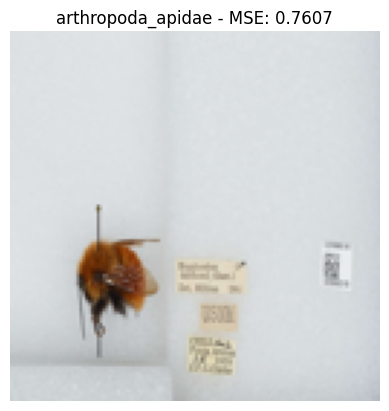

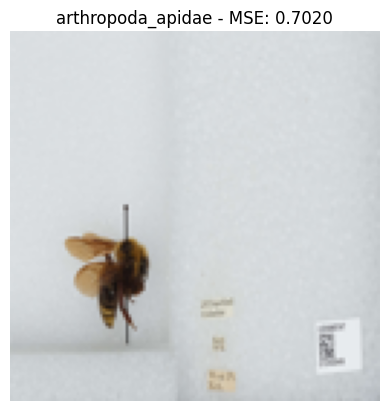

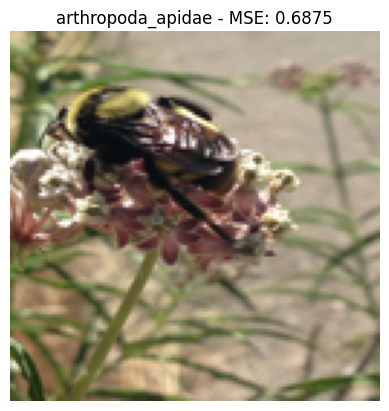

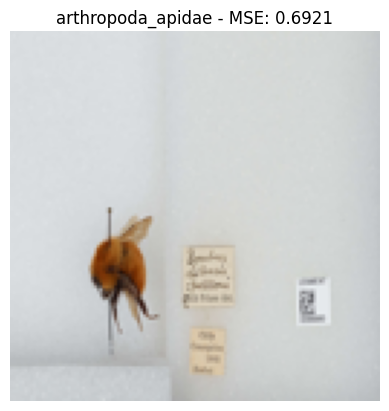

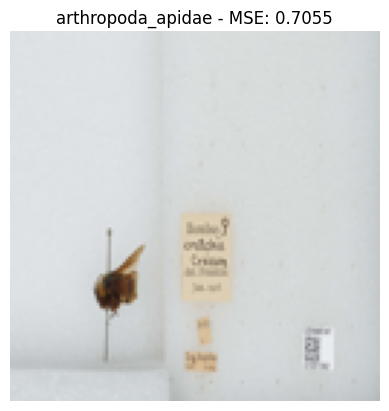

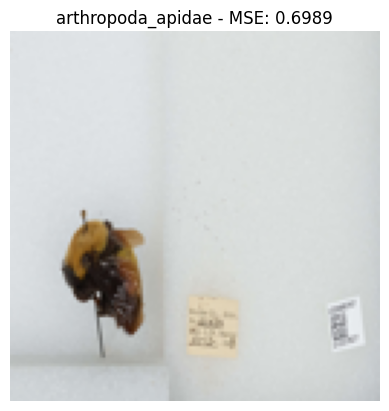

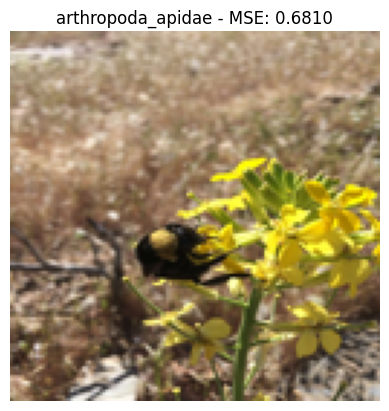

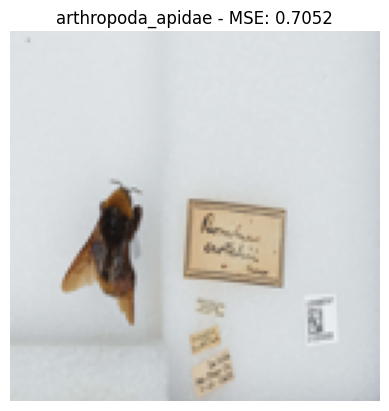

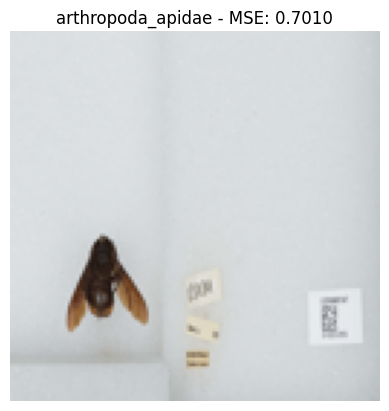

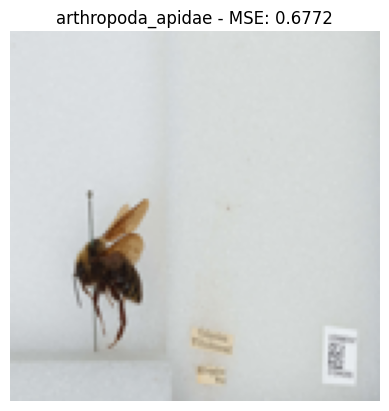


 arthropoda_attelabidae


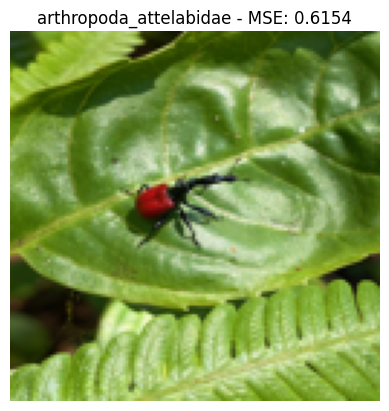

In [30]:
ROOT_DIR = r'/Users/ricardokayseller/Desktop/DATA2'
SCORES_DIR = r'/Users/ricardokayseller/Desktop/ANOMALY_SCORES'
THRESHOLD = 0.50
NUM_CLASSES = 2

transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor()
])

# Custom dataset to load images directly from a flat folder
class FlatFolderDataset(Dataset):
    def __init__(self, folder_path, transform=None):
        self.folder_path = folder_path
        self.image_files = [
            os.path.join(folder_path, f)
            for f in os.listdir(folder_path)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))
        ]
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = self.image_files[idx]
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, image_path

# Function to show anomalous images
def show_anomalies_from_folder(folder_name, score_file):
    folder_path = os.path.join(ROOT_DIR, folder_name)
    dataset = FlatFolderDataset(folder_path, transform=transform)
    scores = np.load(os.path.join(SCORES_DIR, score_file))
    anomalous_indices = np.where(scores > THRESHOLD)[0]

    for idx in anomalous_indices[:10]:
        _, image_path = dataset[idx]
        img = Image.open(image_path).convert("RGB").resize((128, 128))
        plt.imshow(img)
        plt.title(f"{folder_name} - MSE: {scores[idx]:.4f}")
        plt.axis("off")
        plt.show()

# Loop through first N classes
all_score_files = sorted([f for f in os.listdir(SCORES_DIR) if f.endswith("_scores.npy")])[:NUM_CLASSES]

for score_file in all_score_files:
    folder_name = score_file.replace("_scores.npy", "")
    print(f"\n {folder_name}")
    show_anomalies_from_folder(folder_name, score_file)


#### 1.4.1.4 Define paths and threshold

In [31]:
# Redefine paths
SCORES_DIR = r'/Users/ricardokayseller/Desktop/ANOMALY_SCORES'
DATA_DIR = r'/Users/ricardokayseller/Desktop/DATA2'
TO_REMOVE_DIR = r'/Users/ricardokayseller/Desktop/TO_REMOVE'
os.makedirs(TO_REMOVE_DIR, exist_ok=True)

# Threshold for anomaly
THRESHOLD = 0.50

# Process each score file
removal_log = []

for fname in os.listdir(SCORES_DIR):
    if not fname.endswith('_scores.npy'):
        continue
    
    category = fname.replace('_scores.npy', '')
    scores = np.load(os.path.join(SCORES_DIR, fname))
    
    category_path = os.path.join(DATA_DIR, category)
    if not os.path.isdir(category_path):
        continue

    image_filenames = sorted([
        f for f in os.listdir(category_path)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])
    
    for idx, score in enumerate(scores):
        if score > THRESHOLD and idx < len(image_filenames):
            src_path = os.path.join(category_path, image_filenames[idx])
            dst_category_path = os.path.join(TO_REMOVE_DIR, category)
            os.makedirs(dst_category_path, exist_ok=True)
            dst_path = os.path.join(dst_category_path, image_filenames[idx])
            shutil.copy2(src_path, dst_path)
            removal_log.append((category, image_filenames[idx], score))

# Display result
df_removal = pd.DataFrame(removal_log, columns=["Category", "Filename", "MSE_Score"])



#### 1.4.1.5 Remove noise from Data directory

In [32]:
TO_REMOVE_DIR = r'/Users/ricardokayseller/Desktop/TO_REMOVE'
ORIGINAL_DATASET_DIR = r'/Users/ricardokayseller/Desktop/DATA2'

deleted = []

# Loop through each category in TO_REMOVE
for category in os.listdir(TO_REMOVE_DIR):
    category_path = os.path.join(TO_REMOVE_DIR, category)
    if not os.path.isdir(category_path):
        continue

    original_category_path = os.path.join(ORIGINAL_DATASET_DIR, category)
    if not os.path.exists(original_category_path):
        print(f" Category not found in original dataset: {category}")
        continue

    for filename in os.listdir(category_path):
        file_path = os.path.join(original_category_path, filename)
        if os.path.exists(file_path):
            os.remove(file_path)
            deleted.append((category, filename))
        else:
            print(f" File not found in original dataset: {file_path}")

print(f"\n Removed {len(deleted)} files.")



 Removed 1494 files.


#### 1.4.1.6 Clean data

In [33]:
clean_data = r'/Users/ricardokayseller/Desktop/DATA2'

# Contar número de imagens por pasta (classe)
class_counts = []

for class_folder in sorted(os.listdir(clean_data)):
    class_path = os.path.join(clean_data, class_folder)
    if not os.path.isdir(class_path):
        continue

    image_count = len([
        f for f in os.listdir(class_path)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])
    class_counts.append((class_folder, image_count))

# Criar DataFrame
df_class_counts = pd.DataFrame(class_counts, columns=["Class", "Num_Images"])
df_class_counts.sort_values(by="Num_Images", inplace=True)



In [34]:
df_class_counts

,Class,Num_Images
153,chordata_scincidae,14
123,chordata_paradisaeidae,19
124,chordata_pardalotidae,19
138,chordata_pristidae,19
88,chordata_glareolidae,20
...,...,...
45,chordata_carcharhinidae,242
48,chordata_cercopithecidae,242
5,arthropoda_formicidae,249
151,chordata_salamandridae,256


#### 1.4.1.7 Final Clean Dataset

In [35]:
# Normalize TO_REMOVE paths
to_remove_paths = []
for root, dirs, files in os.walk(TO_REMOVE_DIR):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            rel_path = os.path.relpath(os.path.join(root, file), TO_REMOVE_DIR)
            rel_path = rel_path.replace("\\", "/")
            to_remove_paths.append(rel_path)

# Filter DataFrame
original_len = len(df)
filtered_df = df[~df["file_path"].isin(to_remove_paths)]
filtered_len = len(filtered_df)



original_len, filtered_len, original_len - filtered_len


(11983, 10489, 1494)

In [36]:
filtered_df

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,full_path,label
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...,/Users/ricardokayseller/Desktop/DATA2/mollusca...,unionidae
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...,/Users/ricardokayseller/Desktop/DATA2/chordata...,geoemydidae
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...,/Users/ricardokayseller/Desktop/DATA2/chordata...,cryptobranchidae
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...,/Users/ricardokayseller/Desktop/DATA2/chordata...,indriidae
5,dc48f2ce-4feb-4ef7-b2a2-c3c3f42bf19b,28657539,491832,animalia,arthropoda,formicidae,arthropoda_formicidae/28657539_491832_eol-full...,/Users/ricardokayseller/Desktop/DATA2/arthropo...,formicidae
...,...,...,...,...,...,...,...,...,...
11978,1fa96ea5-32fa-4a25-b8d2-fa99f6e2cb89,29734618,1011315,animalia,chordata,leporidae,chordata_leporidae/29734618_1011315_eol-full-s...,/Users/ricardokayseller/Desktop/DATA2/chordata...,leporidae
11979,628bf2b4-6ecc-4017-a8e6-4306849e0cfc,29972861,1056842,animalia,chordata,emydidae,chordata_emydidae/29972861_1056842_eol-full-si...,/Users/ricardokayseller/Desktop/DATA2/chordata...,emydidae
11980,0ecfdec9-b1cd-4d43-96fc-2f8889ec1ad9,30134195,52572074,animalia,chordata,dasyatidae,chordata_dasyatidae/30134195_52572074_eol-full...,/Users/ricardokayseller/Desktop/DATA2/chordata...,dasyatidae
11981,27fdb1e9-c5fb-459a-8b6a-6fb222b1c512,9474963,46559139,animalia,chordata,mustelidae,chordata_mustelidae/9474963_46559139_eol-full-...,/Users/ricardokayseller/Desktop/DATA2/chordata...,mustelidae


In [61]:
output_path = r'/Users/ricardokayseller/Desktop/filtered_dataset.csv'
filtered_df.to_csv(output_path, index=False)
print(f" Dataset exported successfully to: {output_path}")

 Dataset exported successfully to: /Users/ricardokayseller/Desktop/filtered_dataset.csv


## 1.5 GAN With Syntetic Images for Imablanced

### 1.5.1 Analyze Image Distribution in Clean Dataset


In [38]:
#filtered_len

In [39]:
# Count the number of images per family in the filtered dataset
family_counts_filtered = filtered_df['family'].value_counts().reset_index()
family_counts_filtered.columns = ['family', 'image_count']

In [40]:
family_counts_filtered

,family,image_count
0,dactyloidae,282
1,salamandridae,256
2,formicidae,249
3,cercopithecidae,242
4,carcharhinidae,242
...,...,...
197,glareolidae,20
198,pardalotidae,19
199,paradisaeidae,19
200,pristidae,19


In [41]:
# Conta o número de imagens por família
family_counts = filtered_df["family"].value_counts()

# Top 20 famílias com mais imagens
top_20_most = family_counts.sort_values(ascending=False).head(20)

# Top 20 famílias com menos imagens
top_20_least = family_counts.sort_values(ascending=True).head(20)

# Prepara os DataFrames
top_20_most_df = top_20_most.reset_index()
top_20_most_df.columns = ['family', 'image_count']

top_20_least_df = top_20_least.reset_index()
top_20_least_df.columns = ['family', 'image_count']



In [42]:
top_20_least_df

,family,image_count
0,scincidae,14
1,pardalotidae,19
2,pristidae,19
3,paradisaeidae,19
4,glareolidae,20
5,bombycillidae,21
6,alcedinidae,21
7,somniosidae,21
8,siluridae,22
9,vangidae,22


In [43]:
top_20_most_df

,family,image_count
0,dactyloidae,282
1,salamandridae,256
2,formicidae,249
3,cercopithecidae,242
4,carcharhinidae,242
5,plethodontidae,237
6,bovidae,232
7,acroporidae,207
8,bucerotidae,177
9,diomedeidae,153


In [44]:
# Calcular média e mediana a partir de filtered_df
class_counts_from_filtered = filtered_df["family"].value_counts().reset_index()
class_counts_from_filtered.columns = ["family", "image_count"]

# Estatísticas
mean_images = class_counts_from_filtered["image_count"].mean()
median_images = class_counts_from_filtered["image_count"].median()

mean_images, median_images

(51.92574257425743, 30.0)

### 1.5.2 Conditional GAN

#### 1.5.2.1 Global Imports and Configurations


In [45]:
# Count images per family
low_count_families = filtered_df['family'].value_counts()
low_count_families = low_count_families[low_count_families < 52].index.tolist()


In [46]:
low_count_families

['faviidae',
 'emydidae',
 'pocilloporidae',
 'cryptobranchidae',
 'balistidae',
 'sparidae',
 'alopiidae',
 'turdidae',
 'falconidae',
 'scolopacidae',
 'psittaculidae',
 'soricidae',
 'cyprinodontidae',
 'fungiidae',
 'cheirogaleidae',
 'triopsidae',
 'podocnemididae',
 'urolophidae',
 'diploastraeidae',
 'lobophylliidae',
 'helioporidae',
 'cervidae',
 'dendrophylliidae',
 'goodeidae',
 'odontophoridae',
 'platystictidae',
 'coenagrionidae',
 'hynobiidae',
 'otididae',
 'ctenomyidae',
 'latimeriidae',
 'recurvirostridae',
 'sciuridae',
 'tropiduridae',
 'siderastreidae',
 'indriidae',
 'conidae',
 'gliridae',
 'gavialidae',
 'tettigoniidae',
 'dendrobatidae',
 'ramphastidae',
 'balaenidae',
 'equidae',
 'brachypteraciidae',
 'gekkonidae',
 'vireonidae',
 'zonitidae',
 'theraphosidae',
 'viperidae',
 'lutjanidae',
 'attelabidae',
 'potoroidae',
 'carettochelyidae',
 'muscicapidae',
 'dasypodidae',
 'parulidae',
 'haliotidae',
 'elapidae',
 'salmonidae',
 'pisauridae',
 'giraffidae',


In [47]:
# Map family names to indices for embedding layers
family_to_idx = {family: idx for idx, family in enumerate(low_count_families)}
idx_to_family = {idx: family for family, idx in family_to_idx.items()}


In [48]:
# Load filtered DataFrame (already cleaned)
df = filtered_df.copy()

# Root dir for real images
DATA_DIR = r'/Users/ricardokayseller/Desktop/DATA2'

# Filter underrepresented classes (less than 52 images)
family_counts = df['family'].value_counts()
under_families = family_counts[family_counts < 52].index.tolist()
under_df = df[df['family'].isin(under_families)].copy()

# Encode family labels
label_encoder = LabelEncoder()
under_df['label'] = label_encoder.fit_transform(under_df['family'])
family_to_idx = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
idx_to_family = {v: k for k, v in family_to_idx.items()}

# Add full image paths
under_df['full_path'] = under_df['file_path'].apply(lambda x: os.path.join(DATA_DIR, x))

# TF Dataset loader
def load_image_tf(path, label):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [224, 224])
    image = (tf.cast(image, tf.float32) / 127.5) - 1.0
    return image, label

file_paths = under_df['full_path'].values
labels = under_df['label'].values

dataset = tf.data.Dataset.from_tensor_slices((file_paths, labels))
dataset = dataset.map(load_image_tf).shuffle(500).batch(32).prefetch(tf.data.AUTOTUNE)

# Set info for model
NUM_CLASSES = len(label_encoder.classes_)
IMG_SHAPE = (224, 224, 3)
LATENT_DIM = 100


2025-04-25 10:04:09.089845: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1
2025-04-25 10:04:09.090084: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2025-04-25 10:04:09.090097: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2025-04-25 10:04:09.090140: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-04-25 10:04:09.090374: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


#### 1.5.2.2 Define Generator and Discriminator

In [49]:
# Generator
def build_generator():
    label_input = layers.Input(shape=(1,), dtype='int32')
    noise_input = layers.Input(shape=(LATENT_DIM,))
    
    label_embedding = layers.Embedding(NUM_CLASSES, LATENT_DIM)(label_input)
    label_embedding = layers.Flatten()(label_embedding)
    
    x = layers.Multiply()([noise_input, label_embedding])
    
    x = layers.Dense(7 * 7 * 512, use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Reshape((7, 7, 512))(x)

    x = layers.Conv2DTranspose(256, 4, strides=2, padding='same', use_bias=False)(x)  # 14x14
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False)(x)  # 28x28
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(64, 4, strides=2, padding='same', use_bias=False)(x)   # 56x56
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(32, 4, strides=2, padding='same', use_bias=False)(x)   # 112x112
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)

    x = layers.Conv2DTranspose(3, 4, strides=2, padding='same', activation='tanh')(x)  # 224x224
    
    return Model([noise_input, label_input], x, name="generator")

# Discriminator
def build_discriminator():
    embedding_dim = IMG_SHAPE[0] * IMG_SHAPE[1] * IMG_SHAPE[2]

    img_input = layers.Input(shape=IMG_SHAPE)
    label_input = layers.Input(shape=(1,), dtype='int32')

    label_embedding = layers.Embedding(NUM_CLASSES, embedding_dim)(label_input)
    label_embedding = layers.Flatten()(label_embedding)
    label_reshaped = layers.Reshape(IMG_SHAPE)(label_embedding)

    combined_input = layers.Concatenate()([img_input, label_reshaped])

    x = layers.Conv2D(64, kernel_size=3, strides=2, padding='same')(combined_input)   # 112x112
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(128, kernel_size=3, strides=2, padding='same')(x)               # 56x56
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(128, kernel_size=3, strides=2, padding='same')(x)               # 28x28
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(256, kernel_size=3, strides=2, padding='same')(x)               # 14x14
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(512, kernel_size=3, strides=2, padding='same')(x)               # 7x7
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1, activation='sigmoid')(x)
    
    return Model([img_input, label_input], x, name="discriminator")


# Instantiate models
generator = build_generator()
discriminator = build_discriminator()


/Users/ricardokayseller/anaconda3/envs/tf_m1_clean/lib/python3.9/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


#### 1.5.2.3 Define Optimizers

In [50]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

@tf.function
def train_step(images, labels):
    noise = tf.random.normal([tf.shape(images)[0], LATENT_DIM])
    
    with tf.GradientTape() as disc_tape, tf.GradientTape() as gen_tape:
        generated_images = generator([noise, labels], training=True)
        
        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([generated_images, labels], training=True)

        disc_loss = cross_entropy(tf.ones_like(real_output), real_output) + \
                    cross_entropy(tf.zeros_like(fake_output), fake_output)

        gen_loss = cross_entropy(tf.ones_like(fake_output), fake_output)

    gradients_of_gen = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_disc = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_gen, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_disc, discriminator.trainable_variables))

def train(dataset, epochs=100):
    for epoch in range(epochs):
        for image_batch, label_batch in dataset:
            train_step(image_batch, label_batch)
        print(f"Epoch {epoch+1} completed ")

# Call training loop (adjust epochs as needed)
train(dataset, epochs=100)


2025-04-25 10:04:15.337787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.
2025-04-25 10:10:00.130878: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 1 completed 


2025-04-25 10:13:10.136276: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 2 completed 


2025-04-25 10:16:09.456658: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 3 completed 


2025-04-25 10:18:06.050431: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 4 completed 


2025-04-25 10:20:10.605087: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 5 completed 


2025-04-25 10:22:18.097057: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 6 completed 


2025-04-25 10:24:37.364316: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 7 completed 


2025-04-25 10:26:58.178446: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 8 completed 


2025-04-25 10:29:28.379172: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 9 completed 


2025-04-25 10:31:47.264555: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 10 completed 


2025-04-25 10:34:06.722784: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 11 completed 


2025-04-25 10:36:28.855267: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 12 completed 


2025-04-25 10:38:53.157720: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 13 completed 


2025-04-25 10:41:15.391175: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 14 completed 


2025-04-25 10:43:33.370957: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 15 completed 


2025-04-25 10:45:49.783504: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 16 completed 


2025-04-25 10:48:07.958003: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 17 completed 


2025-04-25 10:50:30.203257: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 18 completed 


2025-04-25 10:52:59.367248: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 19 completed 


2025-04-25 10:55:19.581027: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 20 completed 


2025-04-25 10:57:48.890897: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 21 completed 


2025-04-25 11:00:25.789839: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 22 completed 


2025-04-25 11:02:56.496627: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 23 completed 


2025-04-25 11:12:08.852079: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 24 completed 


2025-04-25 11:14:07.276193: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 25 completed 


2025-04-25 11:16:12.029093: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 26 completed 


2025-04-25 11:18:29.755264: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 27 completed 


2025-04-25 11:20:51.893812: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 28 completed 


2025-04-25 11:23:13.446178: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 29 completed 


2025-04-25 11:25:38.758057: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 30 completed 


2025-04-25 11:28:13.979901: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 31 completed 


2025-04-25 11:30:45.994879: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 32 completed 


2025-04-25 11:33:46.678103: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 33 completed 


2025-04-25 11:36:45.653000: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 34 completed 


2025-04-25 11:39:32.390548: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 35 completed 


2025-04-25 11:42:22.943172: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 36 completed 


2025-04-25 11:45:05.351147: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 37 completed 


2025-04-25 11:47:52.967488: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 38 completed 


2025-04-25 11:51:03.301719: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 39 completed 


2025-04-25 11:54:26.113209: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 40 completed 


2025-04-25 11:57:51.212364: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 41 completed 


2025-04-25 12:00:45.516572: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 42 completed 


2025-04-25 12:03:25.777590: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 43 completed 


2025-04-25 12:06:29.083759: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 44 completed 


2025-04-25 12:10:01.191318: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 45 completed 


2025-04-25 12:13:26.154336: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 46 completed 


2025-04-25 12:16:51.880974: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 47 completed 


2025-04-25 12:20:05.634339: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 48 completed 


2025-04-25 12:23:06.539918: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 49 completed 


2025-04-25 12:26:05.343306: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 50 completed 


2025-04-25 12:28:55.517360: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 51 completed 


2025-04-25 12:31:48.670666: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 52 completed 


2025-04-25 12:34:39.103274: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 53 completed 


2025-04-25 12:37:12.199218: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 54 completed 


2025-04-25 12:39:40.337367: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 55 completed 


2025-04-25 12:42:14.087090: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 56 completed 


2025-04-25 12:44:44.453147: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 57 completed 


2025-04-25 12:51:15.719513: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 58 completed 


2025-04-25 12:53:28.295794: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 59 completed 


2025-04-25 12:55:48.888947: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 60 completed 


2025-04-25 12:58:22.577227: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 61 completed 


2025-04-25 13:00:50.851891: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 62 completed 


2025-04-25 13:03:14.994450: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 63 completed 


2025-04-25 13:06:05.947383: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 64 completed 


2025-04-25 13:08:50.461877: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 65 completed 


2025-04-25 13:11:16.374170: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 66 completed 


2025-04-25 13:13:46.226796: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 67 completed 


2025-04-25 13:16:16.531506: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 68 completed 


2025-04-25 13:18:56.235130: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 69 completed 


2025-04-25 13:21:38.613580: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 70 completed 


2025-04-25 13:24:27.067632: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 71 completed 


2025-04-25 13:27:24.082124: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 72 completed 


2025-04-25 13:30:31.372987: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 73 completed 


2025-04-25 13:33:34.464390: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 74 completed 


2025-04-25 13:36:27.692463: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 75 completed 


2025-04-25 13:39:20.268340: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 76 completed 


2025-04-25 13:42:33.908191: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 77 completed 


2025-04-25 13:48:59.810789: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 78 completed 


2025-04-25 13:51:02.854036: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 79 completed 


2025-04-25 13:53:22.252323: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 80 completed 


2025-04-25 13:55:31.924767: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 81 completed 


2025-04-25 13:57:45.400348: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 82 completed 


2025-04-25 13:59:04.538627: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] ShuffleDatasetV3:2: Filling up shuffle buffer (this may take a while): 363 of 500
2025-04-25 13:59:05.694930: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:480] Shuffle buffer filled.
2025-04-25 14:01:10.113060: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 83 completed 


2025-04-25 14:03:18.289099: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 84 completed 


2025-04-25 14:05:29.744433: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 85 completed 


2025-04-25 14:07:52.053523: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 86 completed 


2025-04-25 14:26:15.832728: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 87 completed 


2025-04-25 14:33:19.845822: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 88 completed 


2025-04-25 14:35:14.442757: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 89 completed 


2025-04-25 14:59:55.386372: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 90 completed 


2025-04-25 15:01:57.472328: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 91 completed 


2025-04-25 15:08:40.395245: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 92 completed 


2025-04-25 15:28:04.881991: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 93 completed 


2025-04-25 15:30:05.690896: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 94 completed 


2025-04-25 15:39:18.205600: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 95 completed 


2025-04-25 15:55:07.599945: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 96 completed 


2025-04-25 15:57:06.328190: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 97 completed 


2025-04-25 15:59:05.058544: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 98 completed 


2025-04-25 16:03:22.412178: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 99 completed 
Epoch 100 completed 


2025-04-25 16:05:20.223466: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


#### 1.5.2.4 Images Count per Family

In [51]:
# Count images per family
family_counts = df['family'].value_counts().reset_index()
family_counts.columns = ['family', 'real_images']

# Define mean threshold
TARGET_MEAN = 52

# Calculate number of synthetic images to generate
family_counts['images_to_generate'] = (TARGET_MEAN - family_counts['real_images']).clip(lower=0).astype(int)

# Only keep families that need images
counts_df = family_counts[family_counts['images_to_generate'] > 0].reset_index(drop=True)

#  Filter only families known to the cGAN
counts_df = counts_df[counts_df['family'].isin(family_to_idx.keys())].reset_index(drop=True)

#### 1.5.2.5 Generate Synthetic Images

In [52]:
# Constants
DATA2_DIR = "/Users/ricardokayseller/Desktop/DATA2"
TARGET_MEAN = 52
LATENT_DIM = 100  # should match your generator's input dim

#  Make sure generator and family_to_idx are loaded
# generator = ...
# family_to_idx = ...

# Synthetic entries for the synthetic_df
synthetic_entries = []

# Function to generate an image given a label
def generate_image(label: int) -> Image.Image:
    noise = tf.random.normal([1, LATENT_DIM])
    label_tensor = tf.convert_to_tensor([[label]], dtype=tf.int32)
    generated = generator([noise, label_tensor], training=False)
    generated = (generated[0] + 1.0) * 127.5  # [-1, 1] → [0, 255]
    generated = tf.clip_by_value(generated, 0, 255)
    img_array = tf.cast(generated, tf.uint8).numpy()
    return Image.fromarray(img_array)

# Start smart generation
print(" Scanning folders and generating missing images...")

for family, label in tqdm(family_to_idx.items()):
    phylum = df[df["family"] == family]["phylum"].iloc[0]
    folder_name = f"{phylum}_{family}"
    folder_path = os.path.join(DATA2_DIR, folder_name)
    os.makedirs(folder_path, exist_ok=True)

    # Count existing images
    existing_images = [
        f for f in os.listdir(folder_path)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ]
    current_count = len(existing_images)
    missing = TARGET_MEAN - current_count

    if missing <= 0:
        continue  # Already has enough

    for i in range(missing):
        filename = f"gen_{current_count + i + 1}.jpg"
        file_path = f"{folder_name}/{filename}"
        full_path = os.path.join(DATA2_DIR, file_path)

        img = generate_image(label)
        img.save(full_path)

        synthetic_entries.append({
            "rare_species_id": None,
            "eol_content_id": None,
            "eol_page_id": None,
            "kingdom": "animalia",
            "phylum": phylum,
            "family": family,
            "file_path": file_path,
            "full_path": full_path,
            "source": "synthetic",
            "label": label
        })

# Build DataFrame from new synthetic entries
synthetic_df = pd.DataFrame(synthetic_entries)

# Optional: combine with original df
full_df = pd.concat([df, synthetic_df], ignore_index=True)

print(" Smart generation completed.")
print(f" Synthetic entries added: {len(synthetic_df)}")
print(f" Total dataset size (real + synthetic): {len(full_df)}")


 Scanning folders and generating missing images...


100%|█████████████████████████████████████████| 131/131 [15:13<00:00,  6.97s/it]

 Smart generation completed.
 Synthetic entries added: 3057
 Total dataset size (real + synthetic): 13546


#### 1.5.2.6 Check Families with less then the Mean Defined as Treshold

In [53]:
# Base directory
DATA2_DIR = "/Users/ricardokayseller/Desktop/DATA2"

# Store counts by folder name
image_counts = {}

# Loop over all subdirectories
for folder in os.listdir(DATA2_DIR):
    folder_path = os.path.join(DATA2_DIR, folder)
    if os.path.isdir(folder_path):
        # Count image files in the folder
        count = sum(
            1 for file in os.listdir(folder_path)
            if file.lower().endswith(('.jpg', '.jpeg', '.png'))
        )
        image_counts[folder] = count

# Find families with < 52 images
UNDERREPRESENTED = {k: v for k, v in image_counts.items() if v < 52}

# Print the result
print(" Families with less than 52 images:")
for family_folder, count in sorted(UNDERREPRESENTED.items(), key=lambda x: x[1]):
    print(f"{family_folder}: {count} images")


 Families with less than 52 images:


### 1.5.3  Rebuild synthetic_df from the folders in DATA2

In [54]:
DATA2_DIR = '/Users/ricardokayseller/Desktop/DATA2'
synthetic_entries = []

for folder in os.listdir(DATA2_DIR):
    folder_path = os.path.join(DATA2_DIR, folder)
    if not os.path.isdir(folder_path):
        continue

    # Parse folder name: expected format is phylum_family
    try:
        phylum, family = folder.split('_', 1)
    except ValueError:
        print(f" Skipping malformed folder: {folder}")
        continue

    for file in os.listdir(folder_path):
        if file.lower().startswith("gen_") and file.lower().endswith(('.jpg', '.jpeg', '.png')):
            file_path = os.path.join(folder, file)
            full_path = os.path.join(DATA2_DIR, folder, file)

            synthetic_entries.append({
                "rare_species_id": None,
                "eol_content_id": None,
                "eol_page_id": None,
                "kingdom": "animalia",
                "phylum": phylum,
                "family": family,
                "file_path": file_path,
                "full_path": full_path,
                "source": "synthetic"
            })

# Create synthetic_df
synthetic_df = pd.DataFrame(synthetic_entries)


In [56]:
#print(synthetic_df[["family", "label"]].drop_duplicates().sort_values("label").head())


In [57]:
print(f" synthetic_df has {len(synthetic_df)} entries")
synthetic_df.head()


 synthetic_df has 3057 entries


,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,full_path,source
0,None,None,None,animalia,chordata,balaenidae,chordata_balaenidae/gen_38.jpg,/Users/ricardokayseller/Desktop/DATA2/chordata...,synthetic
1,None,None,None,animalia,chordata,balaenidae,chordata_balaenidae/gen_39.jpg,/Users/ricardokayseller/Desktop/DATA2/chordata...,synthetic
2,None,None,None,animalia,chordata,balaenidae,chordata_balaenidae/gen_49.jpg,/Users/ricardokayseller/Desktop/DATA2/chordata...,synthetic
3,None,None,None,animalia,chordata,balaenidae,chordata_balaenidae/gen_48.jpg,/Users/ricardokayseller/Desktop/DATA2/chordata...,synthetic
4,None,None,None,animalia,chordata,balaenidae,chordata_balaenidae/gen_45.jpg,/Users/ricardokayseller/Desktop/DATA2/chordata...,synthetic


In [58]:
# Encode family into numeric labels
synthetic_df["label"] = synthetic_df["family"].astype("category").cat.codes

# Optional: save mapping if needed later
family_to_label = dict(enumerate(synthetic_df["family"].astype("category").cat.categories))


In [59]:
# Save work 
save_path = r'/Users/ricardokayseller/Desktop/full_df_balanced.csv'
full_df.to_csv(save_path, index=False)
print(f" CSV saved to: {save_path}")


 CSV saved to: /Users/ricardokayseller/Desktop/full_df_balanced.csv


In [60]:
print(f" full_df is ready with {len(full_df)} total entries")
print(full_df["source"].value_counts(dropna=False))


 full_df is ready with 13546 total entries
source
NaN          10489
synthetic     3057
Name: count, dtype: int64


In [75]:
df = pd.read_csv(r'/Users/ricardokayseller/Desktop/full_df_balanced.csv', sep= ',')

In [76]:
df

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,full_path,label,source
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737.0,449393.0,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...,/Users/ricardokayseller/Desktop/DATA2/mollusca...,unionidae,NaN
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394.0,793083.0,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...,/Users/ricardokayseller/Desktop/DATA2/chordata...,geoemydidae,NaN
2,00372441-588c-4af8-9665-29bee20822c0,28895411.0,319982.0,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...,/Users/ricardokayseller/Desktop/DATA2/chordata...,cryptobranchidae,NaN
3,94004bff-3a33-4758-8125-bf72e6e57eab,21252576.0,7250886.0,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...,/Users/ricardokayseller/Desktop/DATA2/chordata...,indriidae,NaN
4,dc48f2ce-4feb-4ef7-b2a2-c3c3f42bf19b,28657539.0,491832.0,animalia,arthropoda,formicidae,arthropoda_formicidae/28657539_491832_eol-full...,/Users/ricardokayseller/Desktop/DATA2/arthropo...,formicidae,NaN
...,...,...,...,...,...,...,...,...,...,...
13541,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_48.jpg,/Users/ricardokayseller/Desktop/DATA2/mollusca...,130,synthetic
13542,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_49.jpg,/Users/ricardokayseller/Desktop/DATA2/mollusca...,130,synthetic
13543,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_50.jpg,/Users/ricardokayseller/Desktop/DATA2/mollusca...,130,synthetic
13544,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_51.jpg,/Users/ricardokayseller/Desktop/DATA2/mollusca...,130,synthetic


In [77]:
# Directory with images
DATA_DIR = "/Users/ricardokayseller/Desktop/DATA_NoNoise_Synthetic"

def check_images_existence(df, data_dir):
    missing_files = []

    for path in df['file_path']:
        full_path = os.path.join(data_dir, path)
        if not os.path.exists(full_path):
            missing_files.append(full_path)

    if missing_files:
        print(f"\n {len(missing_files)} arquivos não encontrados:\n")
        for file in missing_files:
            print(file)
    else:
        print("\n✅ Todas as imagens existem no diretório!")

check_images_existence(df, DATA_DIR)



✅ Todas as imagens existem no diretório!


In [78]:
# New directory base
NEW_DATA_DIR = "/Users/ricardokayseller/Desktop/DATA_NoNoise_Synthetic"

# New 'full_path' 
df['full_path'] = df['file_path'].apply(lambda x: os.path.join(NEW_DATA_DIR, x) if pd.notnull(x) else x)


In [79]:
def check_images_existence(df, data_dir_col='full_path'):
    missing_files = []

    for path in df[data_dir_col]:
        if isinstance(path, str) and not os.path.exists(path):
            missing_files.append(path)

    if missing_files:
        print(f"\n {len(missing_files)} ficheiros não encontrados:\n")
        for file in missing_files:
            print(file)
    else:
        print("\n✅ Todas as imagens existem corretamente!")

check_images_existence(df)



✅ Todas as imagens existem corretamente!


In [80]:
df

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,full_path,label,source
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737.0,449393.0,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,unionidae,NaN
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394.0,793083.0,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,geoemydidae,NaN
2,00372441-588c-4af8-9665-29bee20822c0,28895411.0,319982.0,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,cryptobranchidae,NaN
3,94004bff-3a33-4758-8125-bf72e6e57eab,21252576.0,7250886.0,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,indriidae,NaN
4,dc48f2ce-4feb-4ef7-b2a2-c3c3f42bf19b,28657539.0,491832.0,animalia,arthropoda,formicidae,arthropoda_formicidae/28657539_491832_eol-full...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,formicidae,NaN
...,...,...,...,...,...,...,...,...,...,...
13541,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_48.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13542,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_49.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13543,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_50.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13544,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_51.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic


In [81]:
# New directory base
NEW_DATA_DIR = "/Users/ricardokayseller/Desktop/DATA_NoNoise_Synthetic"

# New 'full_path'
df['full_path'] = df['file_path'].apply(lambda x: os.path.join(NEW_DATA_DIR, x) if pd.notnull(x) else x)

# path to save CSV
output_csv_path = "/Users/ricardokayseller/Desktop/filtered_df_updated.csv"

df.to_csv(output_csv_path, index=False)

print(f"✅ CSV atualizado salvo no Desktop em: {output_csv_path}")



✅ CSV atualizado salvo no Desktop em: /Users/ricardokayseller/Desktop/filtered_df_updated.csv


In [82]:
df

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,full_path,label,source
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737.0,449393.0,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,unionidae,NaN
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394.0,793083.0,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,geoemydidae,NaN
2,00372441-588c-4af8-9665-29bee20822c0,28895411.0,319982.0,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,cryptobranchidae,NaN
3,94004bff-3a33-4758-8125-bf72e6e57eab,21252576.0,7250886.0,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,indriidae,NaN
4,dc48f2ce-4feb-4ef7-b2a2-c3c3f42bf19b,28657539.0,491832.0,animalia,arthropoda,formicidae,arthropoda_formicidae/28657539_491832_eol-full...,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,formicidae,NaN
...,...,...,...,...,...,...,...,...,...,...
13541,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_48.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13542,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_49.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13543,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_50.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
13544,NaN,NaN,NaN,animalia,mollusca,zonitidae,mollusca_zonitidae/gen_51.jpg,/Users/ricardokayseller/Desktop/DATA_NoNoise_S...,130,synthetic
